# Clustering Geolocation Data Intelligently in Python
We have covid -19 cases data which is categorized according to the regions of different states in India


## Project Outline

[**Task 1**](#task1): Exploratory Data Analysis

[**Task 2**](#task2): Visualizing Geographical Data

[**Task 3**](#task3): Clustering Strength / Performance Metric

[**Task 4**](#task4): K-Means Clustering

[**Task 5**](#task5): DBSCAN

[**Task 6**](#task6): HDBSCAN

[**Task 7**](#task7): Addressing Outliers

[**Further Reading**](#further)

In [1]:
import matplotlib
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import pandas as pd
import numpy as np

from tqdm import tqdm

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.datasets import make_blobs
from sklearn.neighbors import KNeighborsClassifier

from ipywidgets import interactive

from collections import defaultdict

# import hdbscan
import folium
import re
import warnings
warnings.filterwarnings("ignore")

cols = ['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4',
        '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', 
        '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', 
        '#000075', '#808080']*10

In [2]:
!pip install folium

<a id='task1'></a>
# Task 1: Exploratory Data Analysis

In [3]:
df = pd.read_csv('D:/CODES/Projects/Covid Circle Identification/Cov.csv')

In [4]:
df.head(10)

,Date,NAME,LAT,LON,Total Confirmed cases,Death,Cured/Discharged/Migrated,New cases,New deaths,New recovered
0,1/30/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0
1,1/31/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0
2,2/1/2020,Kerala,10.8505,76.2711,2,0,0,1,0,0
3,2/2/2020,Kerala,10.8505,76.2711,3,0,0,1,0,0
4,2/3/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0
5,2/4/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0
6,2/5/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0
7,2/6/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0
8,2/7/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0
9,2/8/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0


In [5]:
df.describe()

,LAT,LON,Total Confirmed cases,Cured/Discharged/Migrated,New cases,New deaths,New recovered
count,4692.000000,4692.000000,4692.000000,4692.000000,4692.000000,4692.0,4692.000000
mean,23.185327,81.451837,11393.925192,6908.130648,418.643009,0.0,283.069054
std,6.635913,6.959475,37208.600846,23390.671258,1259.748923,0.0,947.925811
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.0,-1.000000
25%,18.112400,76.271100,39.000000,9.000000,1.000000,0.0,0.000000
50%,23.940800,79.019300,619.000000,197.500000,26.000000,0.0,8.000000
75%,28.218000,85.313100,5233.000000,2736.000000,210.250000,0.0,119.000000
max,34.299600,94.727800,468265.000000,305521.000000,18366.000000,0.0,13401.000000


In [144]:
df.duplicated(subset=['LON', 'LAT']).values.any()

True

In [11]:
df.isna().values.any()

False

In [147]:
df.head()

,Date,NAME,LAT,LON,Total Confirmed cases,Death,Cured/Discharged/Migrated,New cases,New deaths,New recovered
0,1/30/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0
1,1/31/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0
2,2/1/2020,Kerala,10.8505,76.2711,2,0,0,1,0,0
3,2/2/2020,Kerala,10.8505,76.2711,3,0,0,1,0,0
4,2/3/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0


In [12]:
# Print the maximum  value of both Longitude and Latitude
column_lon = df["LON"]
column_lat = df["LAT"]
max_value_lat = column_lat. max()
max_value_lon = column_lon. max()
print(max_value_lat)
print(max_value_lon)


34.2996
94.7278


In [13]:
X = np.array(df[['LON', 'LAT']], dtype='float64')

<a id='task2'></a>
# Task 2: Visualizing Geographical Data


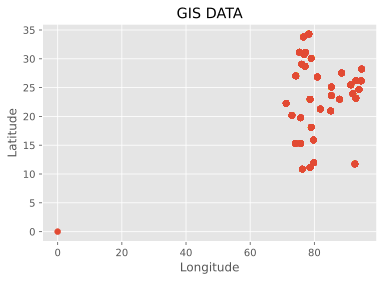

In [14]:
plt.scatter(X[:,0], X[:,1])

plt.title("GIS DATA")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

In [15]:
m = folium.Map(
    location=[df.LAT.mean(), df.LON.mean()],
    tiles='Stamen Toner',
    zoom_start=9
)

for _, row in df.iterrows():
    folium.Circle(
        radius=7,
        location=[row.LAT, row.LON],
        popup=re.sub(r'[^a-zA-Z ]+', '', row.NAME),
        color='blue',
        fill=True,
        fill_colour='#1787FE'
    ).add_to(m)

m

<a id='task3'></a>
# Task 3: Clustering Strength / Performance Metric

In [154]:
X_blobs, _ = make_blobs(n_samples=1000, centers=10, n_features=2, 
                        cluster_std=0.5, random_state=2)


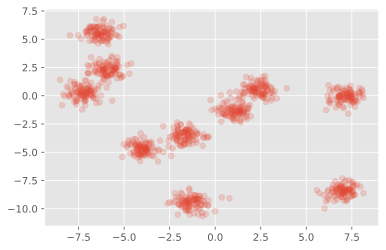

In [155]:
plt.scatter(X_blobs[:,0], X_blobs[:,1],alpha=0.2)

In [156]:
class_predictions = np.load('D:/CODES/Projects/Covid Circel Identification/sample_clusters.npy')


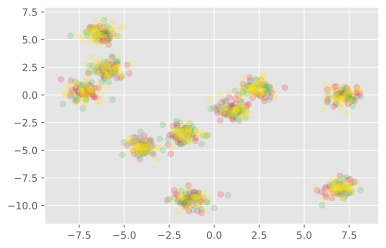

In [157]:
unique_clusters = np.unique(class_predictions)
for unique_cluster in unique_clusters:
    X = X_blobs[class_predictions==unique_cluster]
    plt.scatter(X[:,0], X[:,1], alpha=0.2, c=cols[unique_cluster])
    

In [158]:
silhouette_score(X_blobs, class_predictions)


-0.015272681286231549

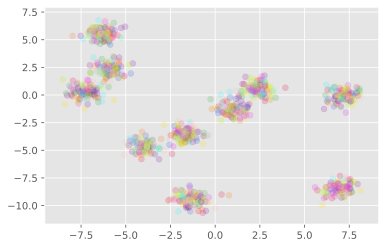

In [159]:
class_predictions = np.load('D:/CODES/Projects/Covid Circel Identification/Taxi Clustering/CompletedProject/Data/sample_clusters_improved.npy')
unique_clusters = np.unique(class_predictions)
for unique_cluster in unique_clusters:
    X = X_blobs[class_predictions==unique_cluster]
    plt.scatter(X[:,0], X[:,1], alpha=0.2, c=cols[unique_cluster])
    

In [99]:
silhouette_score(X_blobs, class_predictions)

-0.07630124748335416

<a id='task4'></a>
# Task 4: K-Means Clustering

In [160]:
X_blobs, _ = make_blobs(n_samples=1000, centers=10, 
                        n_features=2, cluster_std=1, random_state=4)

In [161]:
data = defaultdict(dict)
for x in range(1,21):
    model = KMeans(n_clusters=20, random_state=17, 
                   max_iter=x, n_init=1).fit(X_blobs)
    
    data[x]['class_predictions'] = model.predict(X_blobs)
    data[x]['centroids'] = model.cluster_centers_
    data[x]['unique_classes'] = np.unique(class_predictions)
    

In [162]:
def f(x):
    class_predictions = data[x]['class_predictions']
    centroids = data[x]['centroids']
    unique_classes = data[x]['unique_classes']

    for unique_class in unique_classes:
            plt.scatter(X_blobs[class_predictions==unique_class][:,0], 
                        X_blobs[class_predictions==unique_class][:,1], 
                        alpha=0.3, c=cols[unique_class])
    plt.scatter(centroids[:,0], centroids[:,1], s=200, c='#000000', marker='v')
    plt.ylim([-15,15]); plt.xlim([-15,15])
    plt.title('How K-Means Clusters')

interactive_plot = interactive(f, x=(1, 20))
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(IntSlider(value=10, description='x', max=20, min=1), Output(layout=Layout(height='350px'…

In [163]:
X = np.array(df[['LON', 'LAT']], dtype='float64')
k = 20
model = KMeans(n_clusters=k, random_state=17).fit(X)
class_predictions = model.predict(X)
df[f'CLUSTER_kmeans{k}'] = class_predictions


In [164]:
df.head()

,Date,NAME,LAT,LON,Total Confirmed cases,Death,Cured/Discharged/Migrated,New cases,New deaths,New recovered,CLUSTER_kmeans20
0,1/30/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0,12
1,1/31/2020,Kerala,10.8505,76.2711,1,0,0,0,0,0,12
2,2/1/2020,Kerala,10.8505,76.2711,2,0,0,1,0,0,12
3,2/2/2020,Kerala,10.8505,76.2711,3,0,0,1,0,0,12
4,2/3/2020,Kerala,10.8505,76.2711,3,0,0,0,0,0,12


In [166]:
def create_map(df, cluster_column):
    m = folium.Map(location=[df.LAT.mean(), df.LON.mean()], zoom_start=9, tiles='Stamen Toner')

    for _, row in df.iterrows():

        if row[cluster_column] == -1:
            cluster_colour = '#000000'
        else:
            cluster_colour = cols[row[cluster_column]]

        folium.CircleMarker(
            location= [row['LAT'], row['LON']],
            radius=5,
            popup= row[cluster_column],
            color=cluster_colour,
            fill=True,
            fill_color=cluster_colour
        ).add_to(m)
        
    return m

m = create_map(df, 'CLUSTER_kmeans20')
print(f'K={k}')
print(f'Silhouette Score: {silhouette_score(X, class_predictions)}')

m.save('kmeans_200.html')

K=20
Silhouette Score: 0.7237786194655847


In [167]:
n_samples

NameError: name 'n_samples' is not defined

In [168]:
best_silhouette, best_k = -1, 0

for k in tqdm(range(2, 100)):
    model = KMeans(n_clusters=k, random_state=1).fit(X)
    class_predictions = model.predict(X)
    
    curr_silhouette = silhouette_score(X, class_predictions)
    if curr_silhouette > best_silhouette:
        best_k = k
        best_silhouette = curr_silhouette
        
print(f'K={best_k}')
print(f'Silhouette Score: {best_silhouette}') 


100%|██████████| 98/98 [01:56<00:00,  1.19s/it]

K=36
Silhouette Score: 0.9997868591491605


<a id='task5'></a>
# Task 5: DBSCAN 
Density-Based Spatial Clustering of Applications with Noise

In [169]:
# code for indexing out certain values
dummy = np.array([-1, -1, -1, 2, 3, 4, 5, -1])

new = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(dummy)])


In [170]:
model = DBSCAN(eps=0.01, min_samples=5).fit(X)
class_predictions = model.labels_

df['CLUSTERS_DBSCAN'] = class_predictions

In [171]:
m = create_map(df, 'CLUSTERS_DBSCAN')

    
print(f'Number of clusters found: {len(np.unique(class_predictions))}')
print(f'Number of outliers found: {len(class_predictions[class_predictions==-1])}')

print(f'Silhouette ignoring outliers: {silhouette_score(X[class_predictions!=-1], class_predictions[class_predictions!=-1])}')

no_outliers = 0
no_outliers = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(class_predictions)])
print(f'Silhouette outliers as singletons: {silhouette_score(X, no_outliers)}')

Number of clusters found: 36
Number of outliers found: 1
Silhouette ignoring outliers: 0.9999999878763294
Silhouette outliers as singletons: 0.9997868591491605


In [172]:
m

<a id='task6'></a>
# Task 6: HDBSCAN
Hierarchical DBSCAN

In [173]:
model = hdbscan.HDBSCAN(min_cluster_size=5, min_samples=2, 
                        cluster_selection_epsilon=0.01)
#min_cluster_size
#min_samples
#cluster_slection_epsilon

class_predictions = model.fit_predict(X)
df['CLUSTER_HDBSCAN'] = class_predictions

In [174]:
m = create_map(df, 'CLUSTER_HDBSCAN')

print(f'Number of clusters found: {len(np.unique(class_predictions))-1}')
print(f'Number of outliers found: {len(class_predictions[class_predictions==-1])}')

print(f'Silhouette ignoring outliers: {silhouette_score(X[class_predictions!=-1], class_predictions[class_predictions!=-1])}')

no_outliers = np.array([(counter+2)*x if x==-1 else x for counter, x in enumerate(class_predictions)])
print(f'Silhouette outliers as singletons: {silhouette_score(X, no_outliers)}')

m

Number of clusters found: 35
Number of outliers found: 1
Silhouette ignoring outliers: 0.9999999878763294
Silhouette outliers as singletons: 0.9997868591491605


In [175]:
hdbscan.HDBSCAN?

<a id='task7'></a>
# Task 7: Addressing Outliers


In [176]:
classifier = KNeighborsClassifier(n_neighbors=1)

In [177]:
df_train = df[df.CLUSTER_HDBSCAN!=-1]
df_predict = df[df.CLUSTER_HDBSCAN==-1]

In [178]:
X_train = np.array(df_train[['LON', 'LAT']], dtype='float64')
y_train = np.array(df_train['CLUSTER_HDBSCAN'])

X_predict = np.array(df_predict[['LON', 'LAT']], dtype='float64')

In [179]:
classifier.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=1, p=2,
                     weights='uniform')

In [180]:
predictions = classifier.predict(X_predict)

In [181]:
df['CLUSTER_hybrid'] = df['CLUSTER_HDBSCAN']

In [182]:
df.loc[df.CLUSTER_HDBSCAN==-1, 'CLUSTER_hybrid'] = predictions

In [183]:
m = create_map(df, 'CLUSTER_hybrid')

In [185]:
m

In [186]:
class_predictions = df.CLUSTER_hybrid
print(f'Number of clusters found: {len(np.unique(class_predictions))}')
print(f'Silhouette: {silhouette_score(X, class_predictions)}')
m.save('hybrid.html')

Number of clusters found: 35
Silhouette: 0.9940407178680458


Text(0.5, 0, 'Cluster Sizes')

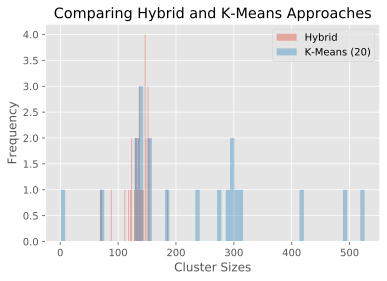

In [189]:
df['CLUSTER_hybrid'].value_counts().plot.hist(bins=70, alpha=0.4, 
                                              label='Hybrid')
df['CLUSTER_kmeans20'].value_counts().plot.hist(bins=70, alpha=0.4,
                                               label='K-Means (20)')
plt.legend()
plt.title('Comparing Hybrid and K-Means Approaches')
plt.xlabel('Cluster Sizes')

<a id='further'></a>
# Further Reading

For some additional reading, feel free to check out [K-Means](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html), [DBSCAN](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html), and [HDBSCAN](https://hdbscan.readthedocs.io/en/latest/) clustering respectively.

It may be of use to also check out [other forms of clustering](https://scikit-learn.org/stable/modules/clustering.html) that are commonly used and available in the scikit-learn library. HDBSCAN documentation also includes [a good methodology](https://hdbscan.readthedocs.io/en/latest/comparing_clustering_algorithms.html) for choosing your clustering algorithm based on your dataset and other limiting factors.